# Causal Discovery Pipeline - Integration Test

This notebook tests the full end-to-end flow of the `Embeddings-based Pre-filtering` architecture.

**Steps:**
1. Initialize Configuration & Directories
2. Load Data (bnlearn 'asia' dataset)
3. Enrich Node Descriptions (Gemini LLM)
4. Generate Embeddings (Gemini Embeddings)
5. Calculate Similarity & Filter Edges
6. Evaluate against Ground Truth

In [19]:
%pip install -r ../requirements.txt

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.0.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [20]:

# %%
# 1. Autoreload extension to pick up changes in src/*.py immediately
%load_ext autoreload
%autoreload 2

import sys
import os
import pandas as pd
import numpy as np

# Add project root to path to verify imports
project_root = os.path.abspath('..')
if project_root not in sys.path:
    sys.path.append(project_root)

print(f"Project Root: {project_root}")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Project Root: c:\Users\user\Desktop\NAU\Дисертація\Проєкти\CausalEmbed


In [21]:

# ## 1. Configuration Check
# Initialize the Singleton Config and verify paths and API keys.

# %%
from src.config import Config

# Reset singleton for testing purposes.
Config._instance = None 

config = Config()
print("✅ Configuration loaded successfully.")

# Verify Paths using the new property signatures
print(f"Raw Data Path: {config.raw_data_path}")
print(f"Cache Path:    {config.cache_path}")

# Check API Key (without printing the whole secret)
if config.google_api_keys:
    print(f"✅ Google API Keys found (starts with {config.google_api_keys[0][:4]}...)")
else:
    print("❌ Google API Keys NOT found. Check your .env file.")

# Check Model Configs
print(f"LLM Model: {config.llm_model_name}")
print(f"Threshold: {config.default_threshold}")

INFO:Config:🔑 Loaded 10 Google API keys for rotation.
INFO:Config:Configuration initialized successfully


✅ Configuration loaded successfully.
Raw Data Path: c:\Users\user\Desktop\NAU\Дисертація\Проєкти\CausalEmbed\data\raw
Cache Path:    c:\Users\user\Desktop\NAU\Дисертація\Проєкти\CausalEmbed\data\interim
✅ Google API Keys found (starts with AIza...)
LLM Model: gemini-3-flash-preview
Threshold: 0.6


In [22]:
# ## 2. Data Loading
# Download and load the dataset using `bnlearn`.

from src.data_loader import DataLoader

dataset_name = 'diabetes'
loader = DataLoader()

print(f"Attempting to load dataset: '{dataset_name}'...")

# 1. Get List of Nodes
nodes = loader.get_node_list(dataset_name)
print(f"✅ Nodes loaded ({len(nodes)}): {nodes}")

# 2. Get Ground Truth Edges
ground_truth_edges = loader.get_ground_truth_edges(dataset_name)
print(f"✅ Ground Truth Edges ({len(ground_truth_edges)}): {list(ground_truth_edges)[:3]} ...")

# 3. Get Stats
stats = loader.get_dataset_stats(dataset_name)
print(f"📊 Stats: {stats}")

Attempting to load dataset: 'diabetes'...
✅ Nodes loaded (413): ['meal_0', 'cho_0', 'cho_init', 'ins_abs_0', 'activ_ins_0', 'ins_sens', 'gut_abs_0', 'bg_0', 'renal_cl_0', 'ins_indep_util_0', 'ins_dep_util_0', 'glu_prod_0', 'ins_indep_0', 'ins_dep_0', 'endo_bal_0', 'cho_bal_0', 'basal_bal_0', 'tot_bal_0', 'met_irr_0', 'meal_1', 'cho_1', 'bg_1', 'ins_abs_1', 'activ_ins_1', 'gut_abs_1', 'renal_cl_1', 'ins_indep_util_1', 'ins_dep_util_1', 'glu_prod_1', 'ins_indep_1', 'ins_dep_1', 'endo_bal_1', 'cho_bal_1', 'basal_bal_1', 'tot_bal_1', 'met_irr_1', 'meal_2', 'cho_2', 'bg_2', 'ins_abs_2', 'activ_ins_2', 'gut_abs_2', 'renal_cl_2', 'ins_indep_util_2', 'ins_dep_util_2', 'glu_prod_2', 'ins_indep_2', 'ins_dep_2', 'endo_bal_2', 'cho_bal_2', 'basal_bal_2', 'tot_bal_2', 'met_irr_2', 'meal_3', 'cho_3', 'bg_3', 'ins_abs_3', 'activ_ins_3', 'gut_abs_3', 'renal_cl_3', 'ins_indep_util_3', 'ins_dep_util_3', 'glu_prod_3', 'ins_indep_3', 'ins_dep_3', 'endo_bal_3', 'cho_bal_3', 'basal_bal_3', 'tot_bal_3', 'met

In [23]:
# ## 3. LLM Node Enrichment
# Use Gemini to generate scientific descriptions for the nodes. 
# *Note: This step should cache results to `data/interim`.*

from src.llm_service import LLMService

print("🚀 Requesting node descriptions from Gemini...")

llm_service = LLMService()
# enrich_nodes signature: (node_list, dataset_name, context_prompt)
descriptions = llm_service.enrich_nodes(
    node_list=nodes, 
    dataset_name=dataset_name
)

print("\n✅ Definitions received:")
for node, desc in list(descriptions.items())[:3]:
    print(f" - **{node}**: {desc[:100]}...")


INFO:LLMService:LLMService initialized with model: gemini-3-flash-preview
INFO:LLMService:Enriching 413 nodes for dataset: diabetes
INFO:LLMService:Loading cached node descriptions from c:\Users\user\Desktop\NAU\Дисертація\Проєкти\CausalEmbed\data\interim\nodes_diabetes.json


🚀 Requesting node descriptions from Gemini...

✅ Definitions received:
 - **meal_0**: Amount of carbohydrates consumed in the first meal....
 - **cho_0**: Net carbohydrate absorption from the first meal into the bloodstream....
 - **cho_init**: Initial net carbohydrate absorption from the meal before systemic effects....


In [24]:
# ## 4. Embedding Generation
# Convert the text descriptions into vector embeddings.
# *Note: This step should also cache results.*

from src.embedding_service import EmbeddingService

emb_service = EmbeddingService()

print("🚀 Generating embeddings...")

# generate_embeddings signature: (text_dict, dataset_name, batch_size)
embeddings = emb_service.generate_embeddings(
    text_dict=descriptions,
    dataset_name=dataset_name
)

# Verify dimensions
dim = emb_service.get_embedding_dimension()
first_vec = list(embeddings.values())[0]

print(f"✅ Embeddings generated for {len(embeddings)} nodes.")
print(f"📊 Vector Dimension: {dim} (Actual shape: {first_vec.shape})")

INFO:EmbeddingService:Loaded 10 API keys for rotation.
INFO:EmbeddingService:Initialized active API key: ...bXw4
INFO:EmbeddingService:EmbeddingService initialized with model: models/gemini-embedding-001
INFO:EmbeddingService:Generating embeddings for 413 texts from dataset: diabetes
INFO:EmbeddingService:Processing 413 texts in 9 batches


🚀 Generating embeddings...


INFO:EmbeddingService:Successfully generated 413 embeddings
INFO:EmbeddingService:Caching embeddings to c:\Users\user\Desktop\NAU\Дисертація\Проєкти\CausalEmbed\data\interim\embeddings_diabetes.npy


✅ Embeddings generated for 413 nodes.
📊 Vector Dimension: 3072 (Actual shape: (3072,))


In [25]:
# ## 5. Graph Processing (Pre-filtering)
# Calculate similarity matrix and apply thresholds to predict edges.

from src.graph_processor import GraphProcessor

processor = GraphProcessor()

# 1. Calculate Similarity Matrix
similarity_matrix, node_order = processor.calculate_similarity_matrix(embeddings)
print("✅ Similarity Matrix calculated.")
display(similarity_matrix.head())

# 2. Filter by Threshold (Strategy 1)
#threshold = 0.5
#predicted_edges_threshold = processor.get_edges_by_threshold(
#    similarity_matrix=similarity_matrix, 
#    threshold=threshold,
#    directed=False # Similarity is symmetric, usually we check undirected first
#)
#print(f"🔹 Edges found (Threshold > {threshold}): {len(predicted_edges_threshold)}")

# 3. Filter by Rank (Strategy 2 - Top K)
k = 10
predicted_edges_rank = processor.get_edges_by_rank(
    similarity_matrix=similarity_matrix, 
    top_k=k
)
print(f"🔹 Edges found (Top-K={k}): {len(predicted_edges_rank)}")

#predicted_edges_random = processor.get_edges_by_random(
#    similarity_matrix=similarity_matrix,
#    count=k)

# Let's use threshold-based edges for evaluation
predicted_edges = predicted_edges_rank

INFO:GraphProcessor:Calculating cosine similarity matrix for 413 nodes


✅ Similarity Matrix calculated.


,meal_0,cho_0,cho_init,ins_abs_0,activ_ins_0,ins_sens,gut_abs_0,bg_0,renal_cl_0,ins_indep_util_0,...,ins_indep_23,ins_dep_23,endo_bal_23,cho_bal_23,basal_bal_23,tot_bal_23,met_irr_23,meal_24,cho_24,bg_24
meal_0,0.000000,0.912492,0.886365,0.841346,0.835085,0.813263,0.883833,0.829786,0.816005,0.822153,...,0.806161,0.813110,0.830210,0.854110,0.810560,0.816368,0.808932,0.899692,0.840174,0.836748
cho_0,0.912492,0.000000,0.939320,0.898737,0.881043,0.819882,0.932615,0.863819,0.857031,0.835091,...,0.822970,0.824563,0.844736,0.878491,0.822541,0.826385,0.837154,0.840784,0.915560,0.856496
cho_init,0.886365,0.939320,0.000000,0.865320,0.849881,0.817995,0.902374,0.845255,0.838454,0.848752,...,0.826330,0.824638,0.846814,0.880913,0.834729,0.836953,0.830944,0.837669,0.881042,0.851068
ins_abs_0,0.841346,0.898737,0.865320,0.000000,0.966214,0.863404,0.884343,0.820428,0.814416,0.831744,...,0.814289,0.834015,0.810524,0.816100,0.802692,0.799298,0.805262,0.789179,0.849701,0.819627
activ_ins_0,0.835085,0.881043,0.849881,0.966214,0.000000,0.853708,0.864286,0.826839,0.816053,0.841623,...,0.828812,0.842648,0.817858,0.806227,0.810267,0.801864,0.812174,0.788620,0.835082,0.830236


🔹 Edges found (Top-K=10): 2587


In [26]:
# ## 6. Evaluation
# Compare the predicted edges (based on semantic similarity) against the ground truth causal edges.

from src.evaluator import Evaluator

print(f"🔍 Evaluating against Ground Truth...")
print(f" - Predicted Edges: {len(predicted_edges)}")
print(f" - True Edges: {len(ground_truth_edges)}")

# Note: Ground Truth in bnlearn is usually directed. 
# Similarity is undirected. We usually evaluate as undirected for pre-filtering 
# (checking if we kept the connection regardless of direction).

evaluator = Evaluator()
num_nodes = len(nodes)
metrics = evaluator.evaluate_undirected(
    predicted_edges=predicted_edges,
    ground_truth_edges=ground_truth_edges,
    num_nodes=num_nodes
)

print("\n📊 --- Evaluation Results ---")
print(metrics)

print(f"\nRecall: {metrics.recall:.2%} (Did we keep the true edges?)")
print(f"Reduction Rate: {metrics.reduction_rate:.2%} (How much 'haystack' did we remove?)")

INFO:Evaluator:Evaluating with undirected edge interpretation
INFO:Evaluator:Evaluating UNDIRECTED: 2587 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.2292, Precision: 0.0533, Reduction Rate: 0.9696


🔍 Evaluating against Ground Truth...
 - Predicted Edges: 2587
 - True Edges: 602

📊 --- Evaluation Results ---
EvaluationMetrics(
  Recall: 0.2292
  Ancestral Recall: 0.1000
  Precision: 0.0533
  Reduction Rate: 0.9696
  True Edges: 602
  Kept Edges: 2587
  Filtered Pairs: 82491
  All Possible Pairs: 85078
)

Recall: 22.92% (Did we keep the true edges?)
Reduction Rate: 96.96% (How much 'haystack' did we remove?)


In [27]:
# Функція для нормалізації ребер (роблять їх неорієнтованими)
def normalize_edges(edges_set):
    return {tuple(sorted(edge)) for edge in edges_set}

# 1. Нормалізуємо істинні ребра (щоб ('A', 'B') стало ('A', 'B') або ('B', 'A') за алфавітом)
ground_truth_edges = normalize_edges(ground_truth_edges)

found_edges = ground_truth_edges.intersection(predicted_edges)
missed_edges = ground_truth_edges - predicted_edges

# filter only where u = THepatitis 
missed_edges = [edge for edge in missed_edges if edge[0] == 'THepatitis' or edge[1] == 'THepatitis']
for u, v in missed_edges:
    print(f"Missed edge: {u} -- {v}, embedding similarity: {similarity_matrix.loc[u, v]:.4f}")

# dispaly predicted edges where u = THepatitis
for u, v in predicted_edges:
    if u == 'THepatitis' or v == 'THepatitis':
        print(f"Predicted edge: {u} -- {v}, embedding similarity: {similarity_matrix.loc[u, v]:.4f}")

# display unique llm descriptions for missed edges
unique_nodes = set()
for u, v in missed_edges:
    unique_nodes.add(u)
    unique_nodes.add(v)
print("\n🔍 Descriptions for nodes in missed edges:")
for node in unique_nodes:
    print(f"\nNode: {node}\nDescription: {descriptions[node]}")


🔍 Descriptions for nodes in missed edges:


In [ ]:
import matplotlib.pyplot as plt
from src.results_manager import ResultsManager
from src.visualization import Visualizer


print("🎨 Generating error analysis plot...")
# figure = Visualizer.plot_error_analysis(
#     sim_matrix=similarity_matrix,
#     ground_truth_edges=ground_truth_edges,
#     predicted_edges=predicted_edges_rank,
#     title=f"Error Analysis ({dataset_name} - Top-K={k})"
# )
#
# display(figure)

# Зберігаємо все разом (CSV, Priors, Plots)
#aver = ResultsManager()
#aver.save_results(
#    dataset_name=dataset_name,
#    strategy_name="rank_top_k",
#    params={"k": config.top_k},
#    metrics=metrics,
#    similarity_matrix=similarity_matrix,
#    predicted_edges=predicted_edges_rank,
#    figure=figure
#)

# Важливо: закрити фігуру, щоб звільнити пам'ять, якщо ви ганяєте це в циклі
#plt.close(figure)

🎨 Generating error analysis plot...


🔄 Starting sensitivity analysis for dataset: diabetes...


INFO:Evaluator:Evaluating UNDIRECTED: 304 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.0532, Precision: 0.1053, Reduction Rate: 0.9964
INFO:Evaluator:Evaluating UNDIRECTED: 1563 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.1545, Precision: 0.0595, Reduction Rate: 0.9816
INFO:Evaluator:Evaluating UNDIRECTED: 2837 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.2492, Precision: 0.0529, Reduction Rate: 0.9667
INFO:Evaluator:Evaluating UNDIRECTED: 3980 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.3522, Precision: 0.0533, Reduction Rate: 0.9532
INFO:Evaluator:Evaluating UNDIRECTED: 5024 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evaluator:Results - Recall: 0.4568, Precision: 0.0547, Reduction Rate: 0.9409
INFO:Evaluator:Evaluating UNDIRECTED: 6044 predicted vs 602 ground truth pairs. Capacity: 85078
INFO:Evalu

,k,recall,ancestral_recall,reduction_rate,precision
0,1,0.053,0.1,0.996,0.105
1,6,0.154,0.1,0.982,0.060
2,11,0.249,0.1,0.967,0.053
3,16,0.352,0.1,0.953,0.053
4,21,0.457,0.1,0.941,0.055
...,...,...,...,...,...
78,391,1.000,0.1,0.007,0.007
79,396,1.000,0.1,0.004,0.007
80,401,1.000,0.1,0.002,0.007
81,406,1.000,0.1,0.001,0.007


📈 Plotting sensitivity graph...


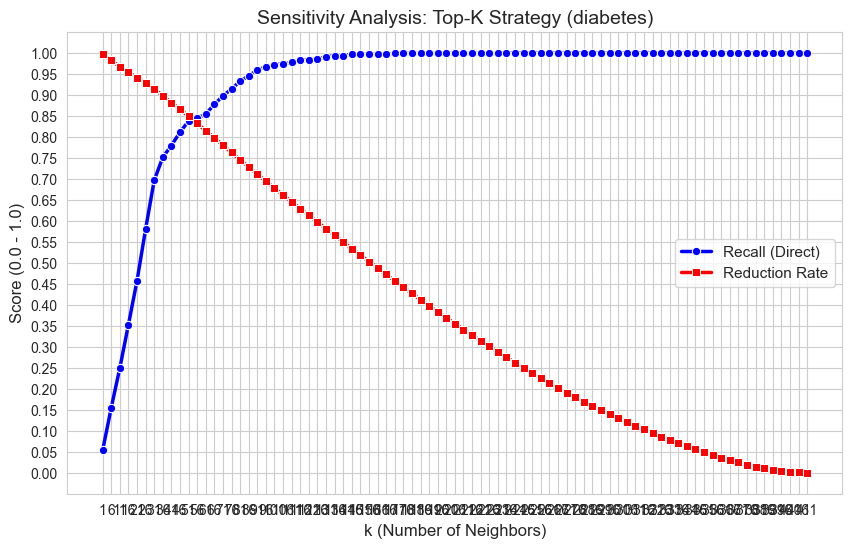

INFO:ResultsManager:✅ All results for 'diabetes' saved successfully.


✅ Sensitivity analysis saved.


In [29]:
import pandas as pd
from src.visualization import Visualizer

all_possible_pairs_count = (num_nodes * (num_nodes - 1)) // 2

step = 5
k_values = range(1, num_nodes, step)
results_list = []

print(f"🔄 Starting sensitivity analysis for dataset: {dataset_name}...")

# 2. Цикл експериментів
for k in k_values:
    # А. Фільтрація (ми просто беремо вже пораховану матрицю схожості)
    predicted_edges = processor.get_edges_by_rank(similarity_matrix, top_k=k)

    # Б. Оцінка
    metrics = evaluator.evaluate(
        predicted_edges=predicted_edges, 
        ground_truth_edges=ground_truth_edges, 
        all_possible_pairs_count=all_possible_pairs_count
    )
    
    # В. Збір даних
    results_list.append({
        "k": k,
        "recall": metrics.recall,
        "ancestral_recall": metrics.ancestral_recall,
        "reduction_rate": metrics.reduction_rate,
        "precision": metrics.precision
    })

# 3. Створення DataFrame
df_sensitivity = pd.DataFrame(results_list)

# Виведемо таблицю для перевірки цифр
display(df_sensitivity.round(3))

# 4. Візуалізація
print("📈 Plotting sensitivity graph...")
fig_sensitivity = Visualizer.plot_k_sensitivity(df_sensitivity, dataset_name=dataset_name)
display(fig_sensitivity)

# 5. Збереження результатів (Графік + CSV)
# Використовуємо наш ResultsManager
saver = ResultsManager()
saver.save_results(
    dataset_name=dataset_name,
    strategy_name="sensitivity_analysis",
    params={"k_range": f"{min(k_values)}-{max(k_values)}"},
    metrics=metrics,
    similarity_matrix=similarity_matrix,
    predicted_edges=set(),
    figure=fig_sensitivity
)

# Окремо збережемо CSV саме цього аналізу, бо save_results пише в загальний лог
df_sensitivity.to_csv(
    config.paths.processed / f"sensitivity_data_{dataset_name}.csv", 
    index=False
)
print("✅ Sensitivity analysis saved.")
plt.close(fig_sensitivity)

In [30]:
# 1. Autoreload extension to pick up changes in src/*.py immediately
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
